## Lessons Learned
1. Ball tracking is sometimes off
    - https://www.kaggle.com/competitions/nfl-big-data-bowl-2024/discussion/448035
    - use player locations and ball carrier info instead of ball locations
        * example: looking for defender closest to ball carrier
    - figure out how to determine the frame when a player catches the ball
2. Ball Carrier is identified in plays.csv
    - `plays_df[['gameId', 'playId', 'ballCarrierId', 'ballCarrierDisplayName']]`
3. Events in the tracking data include "pass_outcome_caught" which is the best indication of the frame where the receiver becomes the ball carrier.
4. Sometime the player identified as the tackling player is over 2 yards from the ball carrier at the time of the tackle. This could be an artifact of the timing of the frames or could be the wrong player identified as tackler.
5. Attempting to identify when a missed tackle occurs:
    - first contact event may be a good filter for some of the missed tackles
    

### Things to Improve
1. Add line of scrimage to single frame visual
1. Make single frame visual match play animation
1. Reduce size of play animation so it fits on my small screen
1. Add visiting colors to color list and select based on game details
    - some teams have similar colors making distinguishing defense and offense difficult (or requires manual intervention)
1. Add carrier_only flag to animation code
    - will allow the caller to show the ball carrier as the only offensive player
1. Add tackler_only flag to animation code
    - will allow the caller to show the tackler as the only defensive player
    - this is assuming the tackler information is in the tackles.csv file
    
### Other Football Questions
1. How to account for blocking
1. How to identify missed tackle frame(s)

In [1]:
!pwd

/Users/marthawood/Documents/Big_Data_Bowl/2024/big_data_bowl_2024/notebooks


In [2]:
# OPTIONAL: Load the "autoreload" extension so that code can change
%load_ext autoreload

# OPTIONAL: always reload modules so that as you change code in src, it gets loaded
%autoreload 2

from src.visualization.visualize import show_frame, animate_play

In [3]:
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

In [4]:
import nfl_data_py as nfl

## Import Data

In [5]:
games_df = pd.read_csv('../data/raw/games.csv')

In [6]:
games_df.head(1)

,gameId,season,week,gameDate,gameTimeEastern,homeTeamAbbr,visitorTeamAbbr,homeFinalScore,visitorFinalScore
0,2022090800,2022,1,09/08/2022,20:20:00,LA,BUF,10,31


In [7]:
plays_df = pd.read_csv('../data/raw/plays.csv')

In [8]:
plays_df.head(1)

,gameId,playId,ballCarrierId,ballCarrierDisplayName,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,yardlineSide,yardlineNumber,gameClock,preSnapHomeScore,preSnapVisitorScore,passResult,passLength,penaltyYards,prePenaltyPlayResult,playResult,playNullifiedByPenalty,absoluteYardlineNumber,offenseFormation,defendersInTheBox,passProbability,preSnapHomeTeamWinProbability,preSnapVisitorTeamWinProbability,homeTeamWinProbabilityAdded,visitorTeamWinProbilityAdded,expectedPoints,expectedPointsAdded,foulName1,foulName2,foulNFLId1,foulNFLId2
0,2022100908,3537,48723,Parker Hesse,(7:52) (Shotgun) M.Mariota pass short middle to P.Hesse to 50 for 9 yards (K.Neal).,4,1,10,ATL,TB,ATL,41,7:52,21,7,C,6.0,NaN,9,9,N,69,SHOTGUN,7.0,0.747284,0.976785,0.023215,-0.00611,0.00611,2.360609,0.981955,NaN,NaN,NaN,NaN


In [9]:
players_df = pd.read_csv('../data/raw/players.csv')

In [10]:
players_df.head(1)

,nflId,height,weight,birthDate,collegeName,position,displayName
0,25511,6-4,225,1977-08-03,Michigan,QB,Tom Brady


In [11]:
tackles_df = pd.read_csv('../data/raw/tackles.csv')

In [12]:
tackles_df.head(1)

,gameId,playId,nflId,tackle,assist,forcedFumble,pff_missedTackle
0,2022090800,101,42816,1,0,0,0


In [13]:
tracking_week_1_df = pd.read_csv('../data/raw/tracking_week_1.csv')

In [14]:
tracking_week_1_df.head(1)

,gameId,playId,nflId,displayName,frameId,time,jerseyNumber,club,playDirection,x,y,s,a,dis,o,dir,event
0,2022090800,56,35472.0,Rodger Saffold,1,2022-09-08 20:24:05.200000,76.0,BUF,left,88.37,27.27,1.62,1.15,0.16,231.74,147.9,NaN


## Visualize single play

In [15]:
game_df = tracking_week_1_df[tracking_week_1_df['gameId'] == 2022090800]

In [16]:
play_df = game_df[game_df['playId'] == 80]

In [17]:
show_frame(play_df, 1)

In [18]:
animate_play(tracking_week_1_df, plays_df, players_df, gameId=2022090800, playId=56)

## EDA - Who is the ball carrier?

Ball Carrier is named in the plays.csv file.
> ballCarrierId: The nflId of the ball carrier (receiver of the handoff, receiver of pass or the QB scrambling) on the play. This is the player that the defense is attempting to tackle. (numeric)

In [19]:
plays_df[['gameId', 'playId', 'ballCarrierId', 'ballCarrierDisplayName']].head()

,gameId,playId,ballCarrierId,ballCarrierDisplayName
0,2022100908,3537,48723,Parker Hesse
1,2022091103,3126,52457,Chase Claypool
2,2022091111,1148,42547,Darren Waller
3,2022100212,2007,46461,Mike Boone
4,2022091900,1372,47857,Devin Singletary


## EDA - Is there a programatic way to find the frame the ball carrier receives the ball?
- investigating event designations
    * How many plays have a pass_arrived? A: 604 in Week 1
    * How many plays were passResult C in week 1? A: 688
    * How many plays have a pass_caught in Week 1? A: 690
        - this looks like the best indicator to use
    * How many plays have a pass_forward in Week 1? A: 11
- using pass_caught event designation....
    * What is the distance between the ball and the ball carrier on this frame?
        - mean =  0.53
        - std =  1.29
        - max =  31.52
        - min =  0.02
    * **the football is not a reliable tracking point**

### When does the reciever catch the ball?

In [20]:
tracking_week_1_df.event.unique()

array([nan, 'pass_arrived', 'pass_outcome_caught', 'tackle', 'run',
       'first_contact', 'ball_snap', 'handoff', 'touchdown',
       'out_of_bounds', 'man_in_motion', 'fumble', 'play_action',
       'pass_forward', 'lateral', 'autoevent_passforward',
       'autoevent_passinterrupted', 'line_set', 'qb_slide', 'shift',
       'run_pass_option', 'qb_sack', 'pass_shovel', 'autoevent_ballsnap',
       'snap_direct', 'fumble_defense_recovered',
       'fumble_offense_recovered'], dtype=object)

In [21]:
pass_arrived_df = tracking_week_1_df[tracking_week_1_df.event == 'pass_arrived']
pass_arrived_df[['gameId', 'playId']].drop_duplicates()

,gameId,playId
1,2022090800,56
2325,2022090800,122
4372,2022090800,167
6052,2022090800,212
6419,2022090800,236
...,...,...
1401438,2022091200,3596
1402151,2022091200,3628
1404222,2022091200,3723
1405691,2022091200,3747


In [22]:
week1_plays = tracking_week_1_df['gameId'].unique()
week1_plays_df = plays_df[plays_df.gameId.isin(week1_plays)]
week1_plays_df.passResult.value_counts()

C    688
R     69
Name: passResult, dtype: int64

In [23]:
pass_caught_df = tracking_week_1_df[tracking_week_1_df.event == 'pass_outcome_caught']
pass_caught_df[['gameId', 'playId']].drop_duplicates()

,gameId,playId
5,2022090800,56
2328,2022090800,122
4375,2022090800,167
6054,2022090800,212
6422,2022090800,236
...,...,...
1401441,2022091200,3596
1402154,2022091200,3628
1404224,2022091200,3723
1405696,2022091200,3747


In [24]:
pass_forward_df = tracking_week_1_df[tracking_week_1_df.event == 'pass_forward']
pass_forward_df[['gameId', 'playId']].drop_duplicates()

,gameId,playId
58941,2022090800,2839
267859,2022091102,189
301751,2022091102,1493
424419,2022091103,2483
720932,2022091106,2358
965496,2022091109,2579
1015450,2022091110,673
1059771,2022091110,2978
1115226,2022091111,1307
1175392,2022091112,611


In [25]:
pass_caught_plays_df = pass_caught_df[['gameId', 'playId']].drop_duplicates()
pass_arrived_plays_df = pass_arrived_df[['gameId', 'playId']].drop_duplicates()
missing_df = pd.concat([pass_caught_plays_df, pass_arrived_plays_df]).drop_duplicates(keep=False)
missing_df.merge(plays_df, on=['gameId', 'playId'])
# The missing plays appear to be pass plays, some down the field.
# I will use pass_outcome_caught to find the frame where the receiver becomes the ball carrier

,gameId,playId,ballCarrierId,ballCarrierDisplayName,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,yardlineSide,yardlineNumber,gameClock,preSnapHomeScore,preSnapVisitorScore,passResult,passLength,penaltyYards,prePenaltyPlayResult,playResult,playNullifiedByPenalty,absoluteYardlineNumber,offenseFormation,defendersInTheBox,passProbability,preSnapHomeTeamWinProbability,preSnapVisitorTeamWinProbability,homeTeamWinProbabilityAdded,visitorTeamWinProbilityAdded,expectedPoints,expectedPointsAdded,foulName1,foulName2,foulNFLId1,foulNFLId2
0,2022090800,3576,44881,Cooper Kupp,(2:16) (Shotgun) M.Stafford pass short left to C.Kupp to BUF 12 for 28 yards (M.Hyde).,4,3,6,LA,BUF,BUF,40,2:16,10,31,C,-1.0,NaN,28,28,N,50,SHOTGUN,6.0,0.985791,0.002449,0.997551,0.000563,-0.000563,2.338848,2.496654,NaN,NaN,NaN,NaN
1,2022091101,272,42347,Amari Cooper,(10:40) (Shotgun) J.Brissett pass short left to A.Cooper to CAR 37 for 6 yards (J.Horn).,1,1,10,CLE,CAR,CAR,43,10:40,0,0,C,6.0,NaN,6,6,N,53,SHOTGUN,7.0,0.585502,0.493211,0.506789,-0.000393,0.000393,3.079520,0.210489,NaN,NaN,NaN,NaN
2,2022091101,662,42347,Amari Cooper,(2:58) (Shotgun) J.Brissett pass short right to A.Cooper to CAR 41 for 2 yards (M.Hartsfield; J.Horn).,1,1,10,CLE,CAR,CAR,43,2:58,0,0,C,-2.0,NaN,2,2,N,53,SHOTGUN,7.0,0.788509,0.495024,0.504976,0.019158,-0.019158,2.984115,-0.406759,NaN,NaN,NaN,NaN
3,2022091101,748,46093,D.J. Moore,(1:53) (Shotgun) B.Mayfield pass short left to D.Moore to CAR 10 for 5 yards (G.Newsome).,1,1,10,CAR,CLE,CAR,5,1:53,0,0,C,3.0,NaN,5,5,N,15,SHOTGUN,7.0,0.661327,0.557884,0.442116,0.000069,-0.000069,0.335856,0.045133,NaN,NaN,NaN,NaN
4,2022091101,1384,43808,Robbie Chosen,(10:02) (Shotgun) B.Mayfield pass short middle to R.Anderson ran ob at CAR 28 for 12 yards (M.Emerson).,2,3,19,CAR,CLE,CAR,16,10:02,0,7,C,0.0,NaN,12,12,N,94,SHOTGUN,6.0,0.918669,0.276199,0.723801,-0.001025,0.001025,-1.267294,0.367943,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81,2022091113,3853,45052,Noah Brown,(2:13) (Shotgun) C.Rush pass deep middle to N.Brown to DAL 43 for 17 yards (M.Edwards; L.Ryan).,4,4,3,DAL,TB,DAL,26,2:13,3,19,C,16.0,NaN,17,17,N,36,SHOTGUN,5.0,0.978165,0.003027,0.996973,0.000994,-0.000994,0.243823,2.181678,NaN,NaN,NaN,NaN
82,2022091113,3971,47911,Tony Pollard,"(:56) (No Huddle, Shotgun) C.Rush pass short middle to T.Pollard to TB 49 for 10 yards (D.White) [V.Vea].",4,4,12,DAL,TB,DAL,41,0:56,3,19,C,4.0,NaN,10,10,N,51,SHOTGUN,5.0,0.993713,0.003131,0.996869,0.000549,-0.000549,0.229049,-1.383081,NaN,NaN,NaN,NaN
83,2022091200,1217,47847,DK Metcalf,(8:48) G.Smith pass short left to D.Metcalf to DEN 37 for -8 yards (B.Browning).,2,2,18,SEA,DEN,DEN,29,8:48,7,3,C,-3.0,NaN,-8,-8,N,39,SINGLEBACK,6.0,0.825803,0.591561,0.408439,-0.039115,0.039115,3.084623,-1.458080,NaN,NaN,NaN,NaN
84,2022091200,2522,47847,DK Metcalf,"(6:17) (Shotgun) G.Smith pass short middle to D.Metcalf to SEA 46 for 15 yards (P.Surtain, C.Sterns).",3,3,10,SEA,DEN,SEA,31,6:17,17,13,C,15.0,NaN,15,15,N,79,SHOTGUN,4.0,0.973836,0.583604,0.416396,0.077576,-0.077576,0.249939,2.519741,NaN,NaN,NaN,NaN


### Where is the receiver when they catch the ball?

In [26]:
carrier_pass_caught_df = pass_caught_df.merge(plays_df, on=['gameId', 'playId'])

In [27]:
frame_carrier_pass = carrier_pass_caught_df[carrier_pass_caught_df['nflId'] == carrier_pass_caught_df['ballCarrierId']]

What is the most efficient way to join the tables and find the info?
Current Idea:
- filter tracking data to frames with event "pass_outcome_caught"
- join plays data
- find ball carrier x y location (match nflId and ballCarrierId)
- find football location (display name? = football)

This is simple enough for these single values, but finding the distance feels like it will need these to be saved into new dataframes and then joined. Is there a better way? Maybe it is enough to use the *find ball carrier* approach and save it back to the tracking dataframe and use it for all calculations.

In [28]:
frame_football_pass = carrier_pass_caught_df[carrier_pass_caught_df['nflId'].isna()]

In [29]:
pass_frame_merge_df = frame_carrier_pass.merge(frame_football_pass[['gameId', 'playId', 'x', 'y']], on=['gameId', 'playId'], suffixes=[None, '_football'])

In [30]:
# !pip install scipy

In [31]:
from scipy.spatial.distance import euclidean
pass_frame_merge_df['distance'] = pass_frame_merge_df.apply(lambda row: euclidean((row['x'], row['y']), (row['x_football'], row['y_football'])), axis=1)
pass_frame_merge_df.head()

,gameId,playId,nflId,displayName,frameId,time,jerseyNumber,club,playDirection,x,y,s,a,dis,o,dir,event,ballCarrierId,ballCarrierDisplayName,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,yardlineSide,yardlineNumber,gameClock,preSnapHomeScore,preSnapVisitorScore,passResult,passLength,penaltyYards,prePenaltyPlayResult,playResult,playNullifiedByPenalty,absoluteYardlineNumber,offenseFormation,defendersInTheBox,passProbability,preSnapHomeTeamWinProbability,preSnapVisitorTeamWinProbability,homeTeamWinProbabilityAdded,visitorTeamWinProbilityAdded,expectedPoints,expectedPointsAdded,foulName1,foulName2,foulNFLId1,foulNFLId2,x_football,y_football,distance
0,2022090800,56,42489.0,Stefon Diggs,6,2022-09-08 20:24:05.700000,14.0,BUF,left,79.85,35.59,4.61,4.82,0.45,114.27,202.20,pass_outcome_caught,42489,Stefon Diggs,(15:00) (Shotgun) J.Allen pass short right to S.Diggs to BUF 31 for 6 yards (J.Ramsey).,1,1,10,BUF,LA,BUF,25,15:00,0,0,C,5.0,NaN,6,6,N,85,SHOTGUN,6.0,0.689960,0.413347,0.586653,-0.000031,0.000031,1.298699,0.004420,NaN,NaN,NaN,NaN,78.220001,37.529999,2.533869
1,2022090800,122,47857.0,Devin Singletary,6,2022-09-08 20:25:51.500000,26.0,BUF,left,67.89,38.41,4.75,1.46,0.47,52.19,335.55,pass_outcome_caught,47857,Devin Singletary,(13:15) (Shotgun) J.Allen pass short right to D.Singletary to LA 49 for 6 yards (B.Wagner).,1,2,3,BUF,LA,BUF,45,13:15,0,0,C,-3.0,NaN,6,6,N,65,SHOTGUN,6.0,0.686939,0.384969,0.615031,-0.019032,0.019032,2.689053,0.399209,NaN,NaN,NaN,NaN,68.129997,38.290001,0.268325
2,2022090800,167,42489.0,Stefon Diggs,6,2022-09-08 20:27:10.900000,14.0,BUF,left,51.68,27.87,5.00,1.40,0.50,117.58,226.52,pass_outcome_caught,42489,Stefon Diggs,(11:54) (Shotgun) J.Allen pass short middle to S.Diggs to LA 35 for 12 yards (L.Floyd).,1,2,8,BUF,LA,LA,47,11:54,0,0,C,6.0,NaN,12,12,N,57,EMPTY,6.0,0.903882,0.387554,0.612446,-0.031870,0.031870,2.574206,1.373441,NaN,NaN,NaN,NaN,51.709999,27.629999,0.241868
3,2022090800,212,52494.0,Zack Moss,6,2022-09-08 20:28:26.200000,20.0,BUF,left,37.68,46.87,7.26,2.74,0.74,93.99,331.40,pass_outcome_caught,52494,Zack Moss,(10:42) (Shotgun) J.Allen pass short right to Z.Moss to LA 26 for 8 yards (B.Wagner).,1,2,9,BUF,LA,LA,34,10:42,0,0,C,6.0,NaN,8,8,N,44,SHOTGUN,6.0,0.880736,0.359685,0.640315,-0.018238,0.018238,3.534322,0.547352,NaN,NaN,NaN,NaN,37.970001,47.049999,0.341322
4,2022090800,236,52536.0,Gabe Davis,6,2022-09-08 20:29:04.500000,13.0,BUF,left,19.30,44.85,8.43,0.93,0.85,315.91,304.27,pass_outcome_caught,52536,Gabe Davis,"(10:03) J.Allen pass short right to G.Davis for 26 yards, TOUCHDOWN.",1,3,1,BUF,LA,LA,26,10:03,0,0,C,15.0,NaN,26,26,N,36,I_FORM,7.0,0.225846,0.341447,0.658553,-0.063681,0.063681,4.081674,2.918326,NaN,NaN,NaN,NaN,19.309999,45.060001,0.210239


mean =  0.5336642529522173
std =  1.2944917780038017
max =  31.516701686598314
min =  0.019998779306219207


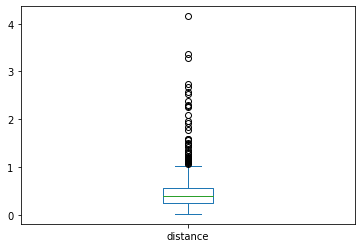

In [32]:
print('mean = ', pass_frame_merge_df['distance'].mean())
print('std = ', pass_frame_merge_df['distance'].std())
print('max = ', pass_frame_merge_df['distance'].max())
print('min = ', pass_frame_merge_df['distance'].min())
pass_frame_merge_df[pass_frame_merge_df['distance'] < 5]['distance'].plot.box()

In [33]:
pass_frame_merge_df[pass_frame_merge_df['distance'] > 5]

,gameId,playId,nflId,displayName,frameId,time,jerseyNumber,club,playDirection,x,y,s,a,dis,o,dir,event,ballCarrierId,ballCarrierDisplayName,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,yardlineSide,yardlineNumber,gameClock,preSnapHomeScore,preSnapVisitorScore,passResult,passLength,penaltyYards,prePenaltyPlayResult,playResult,playNullifiedByPenalty,absoluteYardlineNumber,offenseFormation,defendersInTheBox,passProbability,preSnapHomeTeamWinProbability,preSnapVisitorTeamWinProbability,homeTeamWinProbabilityAdded,visitorTeamWinProbilityAdded,expectedPoints,expectedPointsAdded,foulName1,foulName2,foulNFLId1,foulNFLId2,x_football,y_football,distance
95,2022091101,272,42347.0,Amari Cooper,6,2022-09-11 13:12:02.900000,2.0,CLE,left,47.87,16.61,6.12,1.05,0.62,347.53,324.79,pass_outcome_caught,42347,Amari Cooper,(10:40) (Shotgun) J.Brissett pass short left to A.Cooper to CAR 37 for 6 yards (J.Horn).,1,1,10,CLE,CAR,CAR,43,10:40,0,0,C,6.0,NaN,6,6,N,53,SHOTGUN,7.0,0.585502,0.493211,0.506789,-0.000393,0.000393,3.07952,0.210489,NaN,NaN,NaN,NaN,55.169998,21.780001,8.945327
187,2022091103,4434,46094.0,Hayden Hurst,6,2022-09-11 16:19:49.099999,88.0,CIN,left,22.91,53.63,3.87,1.49,0.39,15.39,319.94,pass_outcome_caught,46094,Hayden Hurst,(5:21) (Shotgun) J.Burrow pass deep right to H.Hurst ran ob at PIT 13 for 20 yards.,5,3,3,CIN,PIT,PIT,33,5:21,20,20,C,18.0,NaN,20,20,N,43,SHOTGUN,5.0,0.780031,0.808340,0.191660,0.118630,-0.118630,3.25431,1.650352,NaN,NaN,NaN,NaN,54.419998,52.980000,31.516702


In [34]:
animate_play(tracking_week_1_df, plays_df, players_df, gameId=2022091101, playId=272)

In [35]:
animate_play(tracking_week_1_df, plays_df, players_df, gameId=2022091103, playId=4434)

## EDA - Is there a programatic way to find the frame the ball carrier is tackled?
    - "tackle" event designation
        * How many plays include this designation?
1. Identify the player(s) closest to the ball carrier when they receive the ball


### Tackle Frame
- There are 1,473 plays in the week 1 tracking data. 
- 1,171 have tackle events.
    * Sometimes the ball carrier runs out of bounds, this could explain why there are fewer tackles than plays.

In [36]:
tackle_frame_df = tracking_week_1_df[tracking_week_1_df.event == 'tackle']

In [37]:
tackle_frame_df.merge(plays_df, on=['gameId', 'playId'])

,gameId,playId,nflId,displayName,frameId,time,jerseyNumber,club,playDirection,x,y,s,a,dis,o,dir,event,ballCarrierId,ballCarrierDisplayName,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,yardlineSide,yardlineNumber,gameClock,preSnapHomeScore,preSnapVisitorScore,passResult,passLength,penaltyYards,prePenaltyPlayResult,playResult,playNullifiedByPenalty,absoluteYardlineNumber,offenseFormation,defendersInTheBox,passProbability,preSnapHomeTeamWinProbability,preSnapVisitorTeamWinProbability,homeTeamWinProbabilityAdded,visitorTeamWinProbilityAdded,expectedPoints,expectedPointsAdded,foulName1,foulName2,foulNFLId1,foulNFLId2
0,2022090800,56,35472.0,Rodger Saffold,18,2022-09-08 20:24:06.900000,76.0,BUF,left,88.230000,27.09,1.72,0.26,0.18,288.76,302.08,tackle,42489,Stefon Diggs,(15:00) (Shotgun) J.Allen pass short right to S.Diggs to BUF 31 for 6 yards (J.Ramsey).,1,1,10,BUF,LA,BUF,25,15:00,0,0,C,5.0,NaN,6,6,N,85,SHOTGUN,6.0,0.689960,0.413347,0.586653,-0.000031,0.000031,1.298699,0.004420,NaN,NaN,NaN,NaN
1,2022090800,56,38577.0,Bobby Wagner,18,2022-09-08 20:24:06.900000,45.0,LA,left,78.620000,32.31,1.76,3.13,0.19,0.84,34.12,tackle,42489,Stefon Diggs,(15:00) (Shotgun) J.Allen pass short right to S.Diggs to BUF 31 for 6 yards (J.Ramsey).,1,1,10,BUF,LA,BUF,25,15:00,0,0,C,5.0,NaN,6,6,N,85,SHOTGUN,6.0,0.689960,0.413347,0.586653,-0.000031,0.000031,1.298699,0.004420,NaN,NaN,NaN,NaN
2,2022090800,56,41239.0,Aaron Donald,18,2022-09-08 20:24:06.900000,99.0,LA,left,91.040000,27.66,2.16,1.98,0.22,273.18,263.65,tackle,42489,Stefon Diggs,(15:00) (Shotgun) J.Allen pass short right to S.Diggs to BUF 31 for 6 yards (J.Ramsey).,1,1,10,BUF,LA,BUF,25,15:00,0,0,C,5.0,NaN,6,6,N,85,SHOTGUN,6.0,0.689960,0.413347,0.586653,-0.000031,0.000031,1.298699,0.004420,NaN,NaN,NaN,NaN
3,2022090800,56,42392.0,Mitch Morse,18,2022-09-08 20:24:06.900000,60.0,BUF,left,87.200000,30.91,1.70,0.72,0.18,286.32,308.98,tackle,42489,Stefon Diggs,(15:00) (Shotgun) J.Allen pass short right to S.Diggs to BUF 31 for 6 yards (J.Ramsey).,1,1,10,BUF,LA,BUF,25,15:00,0,0,C,5.0,NaN,6,6,N,85,SHOTGUN,6.0,0.689960,0.413347,0.586653,-0.000031,0.000031,1.298699,0.004420,NaN,NaN,NaN,NaN
4,2022090800,56,42489.0,Stefon Diggs,18,2022-09-08 20:24:06.900000,14.0,BUF,left,79.330000,33.85,0.62,1.31,0.06,100.54,78.02,tackle,42489,Stefon Diggs,(15:00) (Shotgun) J.Allen pass short right to S.Diggs to BUF 31 for 6 yards (J.Ramsey).,1,1,10,BUF,LA,BUF,25,15:00,0,0,C,5.0,NaN,6,6,N,85,SHOTGUN,6.0,0.689960,0.413347,0.586653,-0.000031,0.000031,1.298699,0.004420,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26923,2022091200,3826,52526.0,Albert Okwuegbunam,49,2022-09-12 23:05:57.799999,85.0,DEN,left,53.300000,14.66,3.14,3.23,0.33,157.75,178.48,tackle,53464,Javonte Williams,(1:11) (Shotgun) R.Wilson pass short left to J.Williams to SEA 46 for 9 yards (J.Brooks).,4,3,14,DEN,SEA,DEN,45,1:11,17,16,C,-6.0,NaN,9,9,N,65,SHOTGUN,3.0,0.916875,0.508994,0.491006,0.282255,-0.282255,0.967420,-0.719924,NaN,NaN,NaN,NaN
26924,2022091200,3826,53464.0,Javonte Williams,49,2022-09-12 23:05:57.799999,33.0,DEN,left,56.060000,10.39,2.35,1.58,0.23,248.15,332.62,tackle,53464,Javonte Williams,(1:11) (Shotgun) R.Wilson pass short left to J.Williams to SEA 46 for 9 yards (J.Brooks).,4,3,14,DEN,SEA,DEN,45,1:11,17,16,C,-6.0,NaN,9,9,N,65,SHOTGUN,3.0,0.916875,0.508994,0.491006,0.282255,-0.282255,0.967420,-0.719924,NaN,NaN,NaN,NaN
26925,2022091200,3826,54505.0,Boye Mafe,49,2022-09-12 23:05:57.799999,53.0,SEA,left,56.730000,7.82,0.98,2.21,0.11,17.90,340.05,tackle,53464,Javonte Williams,(1:11) (Shotgun) R.Wilson pass short left to J.Williams to SEA 46 for 9 yards (J.Brooks).,4,3,14,DEN,SEA,DEN,45,1:11,17,16,C,-6.0,NaN,9,9,N,65,SHOTGUN,3.0,0.916875,0.508994,0.491006,0.282255,-0.282255,0.967420,-0.719924,NaN,NaN,NaN,NaN
26926,2022091200,3826,54618.0,Tariq Woolen,49,202

In [38]:
tackles_df.head()

,gameId,playId,nflId,tackle,assist,forcedFumble,pff_missedTackle
0,2022090800,101,42816,1,0,0,0
1,2022090800,393,46232,1,0,0,0
2,2022090800,486,40166,1,0,0,0
3,2022090800,646,47939,1,0,0,0
4,2022090800,818,40107,1,0,0,0


In [39]:
# This has fewer rows than event=tackles in week 1. Why?
tackles_df.rename(columns={'nflId': 'tacklerId'}, inplace=True)
tackle_details_df = tackles_df[tackles_df['tackle'] == 1]
tackle_details_df = tackle_details_df.merge(plays_df[['gameId', 'playId', 'ballCarrierId']])
tackle_details_df = tackle_details_df.merge(
                        tackle_frame_df[['gameId', 'playId', 'nflId', 'x', 'y', 'frameId']],
                        left_on=['gameId', 'playId', 'tacklerId'],
                        right_on=['gameId', 'playId', 'nflId']
                    )
tackle_details_df.drop('nflId', axis=1, inplace=True)
tackle_details_df.rename(columns={'x': 'tackler_x', 'y': 'tackler_y'}, inplace=True)
    # len = 974
tackle_details_df = tackle_details_df.merge(
                        tackle_frame_df[['gameId', 'playId', 'nflId', 'x', 'y']],
                        left_on=['gameId', 'playId', 'ballCarrierId'],
                        right_on=['gameId', 'playId', 'nflId']
                    )
tackle_details_df.drop('nflId', axis=1, inplace=True)
tackle_details_df.rename(columns={'x': 'ball_carrier_x', 'y': 'ball_carrier_y'}, inplace=True)
    # len = 974

In [40]:
tackle_details_df['distance'] = tackle_details_df.apply(
    lambda row: euclidean((row['tackler_x'], row['tackler_y']), 
                          (row['ball_carrier_x'], row['ball_carrier_y']))
    , axis=1)

mean =  1.1234127184805511
std =  0.9106554473428538
max =  8.730383725816418
min =  0.03999999999999204


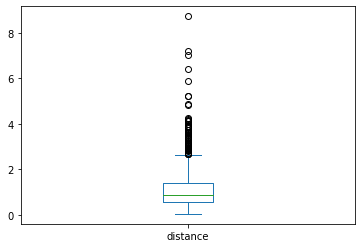

In [41]:
print('mean = ', tackle_details_df['distance'].mean())
print('std = ', tackle_details_df['distance'].std())
print('max = ', tackle_details_df['distance'].max())
print('min = ', tackle_details_df['distance'].min())
tackle_details_df['distance'].plot.box()

In [42]:
tackle_details_df[tackle_details_df['distance'] > 5]

,gameId,playId,tacklerId,tackle,assist,forcedFumble,pff_missedTackle,ballCarrierId,tackler_x,tackler_y,frameId,ball_carrier_x,ball_carrier_y,distance
50,2022091104,3172,46151,1,0,0,0,52461,45.81,50.34,32,49.56,46.73,5.205247
96,2022091111,2725,38551,1,0,0,0,45573,8.82,32.27,40,10.87,37.77,5.869625
173,2022091104,844,46151,1,0,0,0,52461,70.30,39.29,31,63.36,40.42,7.031394
290,2022091105,1480,54502,1,0,0,0,46173,38.55,30.30,45,44.86,31.50,6.423091
448,2022091112,2167,44911,1,0,0,0,52430,54.02,45.48,28,47.16,50.88,8.730384
705,2022091113,1146,52459,1,0,0,0,44816,39.01,4.20,23,33.91,3.06,5.225859
804,2022091110,2765,44848,1,0,0,0,41325,89.30,33.54,68,96.48,33.68,7.181365


In [43]:
tackles_df[(tackles_df['gameId'] == 2022091104) & (tackles_df['playId'] == 3172)]

,gameId,playId,tacklerId,tackle,assist,forcedFumble,pff_missedTackle
60,2022091104,3172,46151,1,0,0,0
15888,2022091104,3172,46958,0,0,0,1


In [44]:
animate_play(tracking_week_1_df, plays_df, players_df, gameId=2022091104, playId=3172)
# Is this an example of the incorrect player labeled as the tackler? 
# closest defender at end of play: Alex Anzalone (nflId 44888)

# This looks like the defender is much closer than 5 yards away.
# Double check the joins using this play as an example.

In [45]:
tracking_week_1_df['event'].value_counts()

first_contact                28773
tackle                       26928
ball_snap                    16415
pass_outcome_caught          15870
handoff                      15364
pass_arrived                 13915
out_of_bounds                 5037
run                           2737
man_in_motion                 1288
play_action                   1035
touchdown                     1012
fumble                         621
shift                          368
qb_slide                       350
pass_forward                   248
snap_direct                     46
line_set                        46
lateral                         45
autoevent_ballsnap              30
run_pass_option                 23
qb_sack                         23
pass_shovel                     23
fumble_defense_recovered        23
fumble_offense_recovered        23
autoevent_passinterrupted       16
autoevent_passforward            9
Name: event, dtype: int64

# Quick EDA on missed tackles
- How many are there in week 1?
    * How many on running plays?

In [46]:
tackle_df = pd.read_csv('../data/raw/tackles.csv')
tackle_df.head()

,gameId,playId,nflId,tackle,assist,forcedFumble,pff_missedTackle
0,2022090800,101,42816,1,0,0,0
1,2022090800,393,46232,1,0,0,0
2,2022090800,486,40166,1,0,0,0
3,2022090800,646,47939,1,0,0,0
4,2022090800,818,40107,1,0,0,0


In [47]:
week_1_games = tracking_week_1_df['gameId'].unique()
tackles_week_1_df = tackle_df[tackle_df['gameId'].isin(week_1_games)]

In [48]:
tackles_week_1_df = tackles_week_1_df.merge(plays_df[['gameId', 'playId', 'passResult', 'passLength']], on=['gameId', 'playId'])

In [49]:
tackles_week_1_df[(tackles_week_1_df['passResult'].isnull()) & (tackles_week_1_df['passLength'].isnull())]
# passResult is null in 1103 rows, passLength is null in all these rows

,gameId,playId,nflId,tackle,assist,forcedFumble,pff_missedTackle,passResult,passLength
0,2022090800,101,42816,1,0,0,0,NaN,NaN
1,2022090800,393,46232,1,0,0,0,NaN,NaN
7,2022090800,1736,44976,1,0,0,0,NaN,NaN
10,2022090800,3145,52647,1,0,0,0,NaN,NaN
11,2022090800,3362,46190,1,0,0,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...
2044,2022091102,1286,45345,0,0,0,1,NaN,NaN
2047,2022091104,288,47974,0,0,0,1,NaN,NaN
2048,2022091104,1660,53542,0,0,0,1,NaN,NaN
2049,2022091105,3413,52498,0,0,0,1,NaN,NaN


In [50]:
tackles_week_1_df['runPlay'] = tackles_week_1_df['passResult'].isnull()

In [51]:
tackles_week_1_df.head()

,gameId,playId,nflId,tackle,assist,forcedFumble,pff_missedTackle,passResult,passLength,runPlay
0,2022090800,101,42816,1,0,0,0,NaN,NaN,True
1,2022090800,393,46232,1,0,0,0,NaN,NaN,True
2,2022090800,486,40166,1,0,0,0,C,6.0,False
3,2022090800,646,47939,1,0,0,0,C,-3.0,False
4,2022090800,818,40107,1,0,0,0,C,-4.0,False


In [52]:
tackles_week_1_df.groupby('runPlay')[['pff_missedTackle', 'tackle']].sum()

,pff_missedTackle,tackle
runPlay,,
False,113,654
True,143,560


In week 1 there were 113 missed tackles on pass plays and 143 missed tackles on run plays.

## EDA - Missed Tackles connection to First Contact
The first contact frame may be a decent way to indicate a missed tackle. It is not an exact match, but could be a decent indicator.

In [53]:
contact_frame_df = tracking_week_1_df[tracking_week_1_df.event == 'first_contact']

In [71]:
tackles_df.rename(columns={'nflId': 'tacklerId'}, inplace=True)
tackle_details_df = tackles_df[tackles_df['pff_missedTackle'] == 1]
print(len(tackle_details_df))
tackle_details_df = tackle_details_df.merge(plays_df[['gameId', 'playId', 'ballCarrierId']])
print(len(tackle_details_df))
tackle_details_df = tackle_details_df.merge(
                        contact_frame_df[['gameId', 'playId', 'nflId', 'x', 'y', 'frameId']],
                        left_on=['gameId', 'playId', 'tacklerId'],
                        right_on=['gameId', 'playId', 'nflId']
                    )
print(len(tackle_details_df))
    # len = 246
tackle_details_df.drop('nflId', axis=1, inplace=True)
tackle_details_df.rename(columns={'x': 'tackler_x', 'y': 'tackler_y'}, inplace=True)
print(len(tackle_details_df))
    # len = 246
tackle_details_df = tackle_details_df.merge(
                        contact_frame_df[['gameId', 'playId', 'nflId', 'x', 'y']],
                        left_on=['gameId', 'playId', 'ballCarrierId'],
                        right_on=['gameId', 'playId', 'nflId']
                    )
print(len(tackle_details_df))
tackle_details_df.drop('nflId', axis=1, inplace=True)
tackle_details_df.rename(columns={'x': 'ball_carrier_x', 'y': 'ball_carrier_y'}, inplace=True)
    # len = 182

2090
2090
246
246
246


In [72]:
tackle_details_df['distance'] = tackle_details_df.apply(
    lambda row: euclidean((row['tackler_x'], row['tackler_y']), 
                          (row['ball_carrier_x'], row['ball_carrier_y']))
    , axis=1)

mean =  2.2330835261319213
std =  3.191452001108705
max =  23.039639754128103
min =  0.1838477631085024


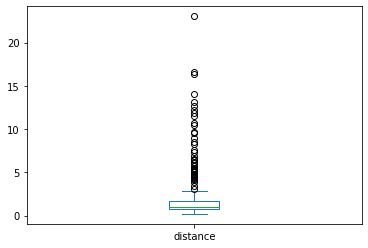

In [73]:
print('mean = ', tackle_details_df['distance'].mean())
print('std = ', tackle_details_df['distance'].std())
print('max = ', tackle_details_df['distance'].max())
print('min = ', tackle_details_df['distance'].min())
tackle_details_df['distance'].plot.box()

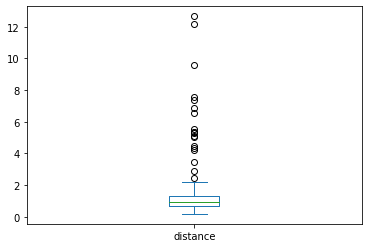

In [74]:
tackle_details_df.groupby(['gameId', 'playId'])['distance'].min().plot.box()

In [75]:
missed_tackle_df = tackle_details_df.groupby(['gameId', 'playId'])['distance'].min()

In [78]:
missed_tackle_df[missed_tackle_df < 0.5]

gameId      playId
2022090800  1102      0.325576
2022091100  395       0.496488
            2332      0.497293
2022091101  2407      0.403113
2022091102  698       0.494065
            1050      0.403609
            2065      0.477598
2022091104  689       0.379473
            1736      0.183848
2022091106  2405      0.418808
            3337      0.278568
2022091107  1120      0.254951
            2385      0.480416
2022091108  1333      0.480104
            2208      0.450999
2022091109  4096      0.487647
2022091111  430       0.375766
2022091200  3628      0.496488
            3723      0.393573
Name: distance, dtype: float64

In [60]:
tackles_df[(tackles_df['pff_missedTackle'] == 1) & (tackles_df['gameId'] <= 2022091200)].groupby(['gameId', 'playId'])['pff_missedTackle'].sum()
#1777 plays (216 in week 1)
# max of 6 missed tackles in a single play

gameId      playId
2022090800  1102      1
            1385      2
            2163      1
            2208      1
            2336      1
                     ..
2022091200  3125      1
            3173      1
            3628      1
            3723      2
            3826      1
Name: pff_missedTackle, Length: 216, dtype: int64

In [61]:
missed_tackle_df
# 155 plays in missed_tackle_df

gameId      playId
2022090800  1102       1.200708
            1385       4.843810
            2163       8.160398
            2208      10.652385
            2336       6.070667
                        ...    
2022091200  3125       4.988387
            3173       8.142788
            3628       5.289234
            3723       8.846208
            3826       9.628510
Name: distance, Length: 155, dtype: float64

In [62]:
week1_missed_df = tackles_df[(tackles_df['pff_missedTackle'] == 1) & (tackles_df['gameId'] <= 2022091200)]

In [68]:
week1_first_contact_df = tracking_week_1_df.query("event == 'first_contact'")
first_contact_plays = week1_first_contact_df['playId'].unique()
week1_missed_df.query("playId not in @first_contact_plays")
# some plays do not have a first_contact event, even if they have a missed tackle

,gameId,playId,tacklerId,tackle,assist,forcedFumble,pff_missedTackle
15639,2022091112,181,54487,0,0,0,1
15766,2022091107,2092,46255,0,0,0,1
15887,2022091104,3122,47900,0,0,0,1
16919,2022091111,475,53476,0,0,0,1
16920,2022091111,475,47913,0,0,0,1
17085,2022091103,3126,47855,0,0,0,1
17119,2022091103,5039,43299,0,0,0,1
17120,2022091103,5039,46146,0,0,0,1


In [64]:
tracking_week_1_df.query('gameId == 2022091103 and playId == 5039')['event'].unique()

array([nan, 'pass_arrived', 'pass_outcome_caught', 'tackle'], dtype=object)

In [65]:
animate_play(tracking_week_1_df, plays_df, players_df, gameId=2022091103, playId=5039)

## EDA - what is the smallest distance in a play between defender who misses a tackle and the ball carrier
- I determined the frame where the "tackler" was closest to the ball carrier, then found the frame with the event "first_contact". Most of the first_contact frames are within 0.25 seconds of the of the frame where the "tackler" is closest to the ball carrier.

In [95]:
tackles_df.rename(columns={'nflId': 'tacklerId'}, inplace=True)
tackle_details_df = tackles_df[tackles_df['pff_missedTackle'] == 1]
tackle_details_df = tackle_details_df.merge(plays_df[['gameId', 'playId', 'ballCarrierId']])
tackle_details_df = tackle_details_df.merge(
                        tracking_week_1_df[['gameId', 'playId', 'nflId', 'x', 'y', 'frameId', 'event']],
                        left_on=['gameId', 'playId', 'tacklerId'],
                        right_on=['gameId', 'playId', 'nflId']
                    )

tackle_details_df.drop('nflId', axis=1, inplace=True)
tackle_details_df.rename(columns={'x': 'tackler_x', 'y': 'tackler_y'}, inplace=True)

tackle_details_df = tackle_details_df.merge(
                        tracking_week_1_df[['gameId', 'playId', 'nflId', 'x', 'y', 'frameId']],
                        left_on=['gameId', 'playId', 'ballCarrierId', 'frameId'],
                        right_on=['gameId', 'playId', 'nflId', 'frameId']
                    )

tackle_details_df.drop('nflId', axis=1, inplace=True)
tackle_details_df.rename(columns={'x': 'ball_carrier_x', 'y': 'ball_carrier_y'}, inplace=True)

In [96]:
tackle_details_df['distance'] = tackle_details_df.apply(
    lambda row: euclidean((row['tackler_x'], row['tackler_y']), 
                          (row['ball_carrier_x'], row['ball_carrier_y']))
    , axis=1)

In [97]:
distance = tackle_details_df.groupby(['gameId', 'playId'])['distance'].min()

mean =  0.7482053693232247
std =  0.8098910769951945
max =  9.653377647227938
min =  0.05099019513592851


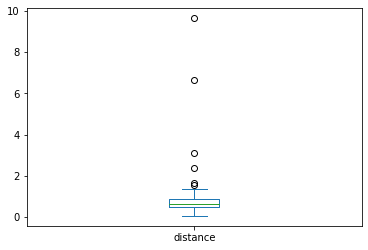

In [98]:
print('mean = ', distance.mean())
print('std = ', distance.std())
print('max = ', distance.max())
print('min = ', distance.min())
distance.plot.box()

In [102]:
min_dist_df = tackle_details_df.loc[tackle_details_df.groupby(['gameId', 'playId'])['distance'].idxmin()][['gameId', 'playId', 'frameId', 'tacklerId', 'ballCarrierId', 'distance']]

In [103]:
first_contact_df = tackle_details_df.query("event == 'first_contact'")

In [110]:
missed_tackles_df = min_dist_df.merge(
    first_contact_df[['gameId', 'playId', 'frameId', 'distance', 'tacklerId']],
    on=['gameId', 'playId', 'tacklerId'],
    suffixes=[None,'_contact']
)

In [114]:
missed_tackles_df

,gameId,playId,frameId,tacklerId,ballCarrierId,distance,frameId_contact,distance_contact
0,2022090800,1102,14,52492,52494,0.325576,14,0.325576
1,2022090800,1385,57,40107,47853,0.745185,55,1.049238
2,2022090800,2163,43,43335,47857,0.431045,40,0.945780
3,2022090800,2208,14,42816,47857,0.628013,16,0.891572
4,2022090800,2336,12,46190,47853,0.912688,10,1.180042
...,...,...,...,...,...,...,...,...
203,2022091200,3125,15,42827,53464,0.710211,16,1.137585
204,2022091200,3173,42,44873,42358,0.516624,42,0.516624
205,2022091200,3628,11,44873,52526,0.100000,10,0.496488
206,2022091200,3723,57,52435,53464,0.390128,18,1.264002


In [265]:
missed_tackles_df_left = min_dist_df.merge(
    first_contact_df[['gameId', 'playId', 'frameId', 'distance', 'tacklerId']],
    how='left',
    on=['gameId', 'playId', 'tacklerId'],
    suffixes=[None,'_contact']
)

In [266]:
missed_tackles_df_left

,gameId,playId,frameId,tacklerId,ballCarrierId,distance,frameId_contact,distance_contact
0,2022090800,1102,14,52492,52494,0.325576,14.0,0.325576
1,2022090800,1385,57,40107,47853,0.745185,55.0,1.049238
2,2022090800,2163,43,43335,47857,0.431045,40.0,0.945780
3,2022090800,2208,14,42816,47857,0.628013,16.0,0.891572
4,2022090800,2336,12,46190,47853,0.912688,10.0,1.180042
...,...,...,...,...,...,...,...,...
211,2022091200,3125,15,42827,53464,0.710211,16.0,1.137585
212,2022091200,3173,42,44873,42358,0.516624,42.0,0.516624
213,2022091200,3628,11,44873,52526,0.100000,10.0,0.496488
214,2022091200,3723,57,52435,53464,0.390128,18.0,1.264002


In [116]:
missed_tackles_df['frame_to_min_dist'] = missed_tackles_df.apply(lambda row: row['frameId'] - row['frameId_contact'], axis=1)

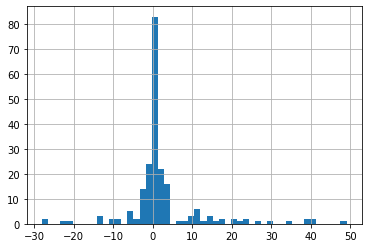

In [122]:
missed_tackles_df['frame_to_min_dist'].hist(bins=50)

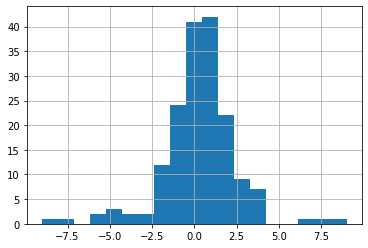

In [130]:
missed_tackles_df.query('frame_to_min_dist > -10 and frame_to_min_dist < 10')['frame_to_min_dist'].hist(bins=19)

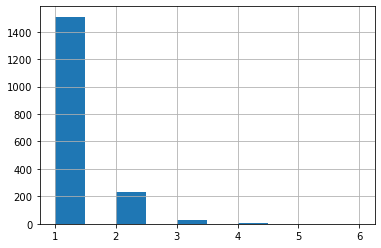

In [132]:
tackles_df[(tackles_df['pff_missedTackle'] == 1) & (tackles_df['gameId'] <= 2023091200)].groupby(['gameId', 'playId'])['pff_missedTackle'].sum().hist()

## EDA - Explore NFLVerse data
Error loading data - need to debug, don't know if it is worth the time

In [66]:
# nfl.import_pbp_data([2022])
nfl.see_pbp_cols()

Index(['play_id', 'game_id', 'old_game_id', 'home_team', 'away_team',
       'season_type', 'week', 'posteam', 'posteam_type', 'defteam',
       ...
       'out_of_bounds', 'home_opening_kickoff', 'qb_epa', 'xyac_epa',
       'xyac_mean_yardage', 'xyac_median_yardage', 'xyac_success', 'xyac_fd',
       'xpass', 'pass_oe'],
      dtype='object', length=372)

# Missed Tackles From YouTube

https://www.youtube.com/watch?v=U5c6dfPVskY

|Game ID | Play ID|
|--------|--------|
|2022110610 | 3617 - scramble|
|2022100904 | 3048 - scramble|
|2022091103 | 5039 - pass|
|2022100202 | 1293 - pass|
|2022100202 | 1767 - scramble|
|2022092501 | 155 - scramble|

https://www.youtube.com/watch?v=QExTAXYC8-0

|Game ID | Play ID|
|--------|--------|
|2022101610 | 3921 - QB run|
|2022110601 | 2084s - scramble|
|2022091104 | 86 - run|
|2022091100 | 546 - QB run|
|2022091103 | 1672 - run (no missed tackle?)|
|2022091109 | 3678 - run|
|2022091108 | 1948 - run (no missed tackle?)|
|2022091112 | 2246 - run|
|2022091802 | 567 - run|
|2022091803 | 1099 - run|
|2022091800 | 2801 - QB run|
|**2022091805** | **3127 - run**|

In [67]:
possession_team = 'CAR'
defensive_team = 'NYG'
quarter = 4
plays_df[
    (plays_df['possessionTeam'] == possession_team)
    & (plays_df['defensiveTeam'] == defensive_team)
    & (plays_df['quarter'] == quarter)
].sort_values('gameClock')

,gameId,playId,ballCarrierId,ballCarrierDisplayName,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,yardlineSide,yardlineNumber,gameClock,preSnapHomeScore,preSnapVisitorScore,passResult,passLength,penaltyYards,prePenaltyPlayResult,playResult,playNullifiedByPenalty,absoluteYardlineNumber,offenseFormation,defendersInTheBox,passProbability,preSnapHomeTeamWinProbability,preSnapVisitorTeamWinProbability,homeTeamWinProbabilityAdded,visitorTeamWinProbilityAdded,expectedPoints,expectedPointsAdded,foulName1,foulName2,foulNFLId1,foulNFLId2
1217,2022091805,3181,44820,Christian McCaffrey,(11:40) C.McCaffrey left tackle to NYG 15 for 6 yards (F.Moreau; T.Crowder).,4,1,10,CAR,NYG,NYG,21,11:40,16,13,NaN,NaN,NaN,6,6,N,31,SINGLEBACK,7.0,0.482077,0.432977,0.567023,-0.028981,0.028981,4.531161,0.291149,NaN,NaN,NaN,NaN
7013,2022091805,3127,44820,Christian McCaffrey,(12:31) C.McCaffrey left guard to NYG 26 for 49 yards (F.Moreau).,4,1,10,CAR,NYG,CAR,25,12:31,16,13,NaN,NaN,NaN,49,49,N,85,SINGLEBACK,7.0,0.587412,0.605465,0.394535,-0.159812,0.159812,1.270372,2.951436,NaN,NaN,NaN,NaN
7108,2022091805,3677,44820,Christian McCaffrey,(2:47) (Shotgun) B.Mayfield pass short right to C.McCaffrey pushed ob at CAR 46 for 4 yards (T.Jefferson) [D.Holmes].,4,2,10,CAR,NYG,CAR,42,2:47,19,16,C,2.0,NaN,4,4,N,68,EMPTY,6.0,0.874836,0.653532,0.346468,0.017230,-0.017230,1.618924,-0.381859,NaN,NaN,NaN,NaN
5523,2022091805,3598,44820,Christian McCaffrey,(3:34) B.Mayfield pass short right to C.McCaffrey to CAR 35 for 10 yards (M.McFadden).,4,1,10,CAR,NYG,CAR,25,3:34,19,16,C,-2.0,NaN,10,10,N,85,SINGLEBACK,7.0,0.795223,0.660172,0.339828,-0.014312,0.014312,1.177978,0.517073,NaN,NaN,NaN,NaN


In [134]:
tracking_week_2_df = pd.read_csv('../data/raw/tracking_week_2.csv')

In [138]:
animate_play(tracking_week_2_df, plays_df, players_df, gameId=2022091805, playId=3127)

In [136]:
tackles_df.query('gameId == 2022091805 and playId == 3127')

,gameId,playId,tacklerId,tackle,assist,forcedFumble,pff_missedTackle
413,2022091805,3127,44893,1,0,0,0
15791,2022091805,3127,52518,0,0,0,1
15792,2022091805,3127,41336,0,0,0,1


### Missed Tackles:
Frame 32
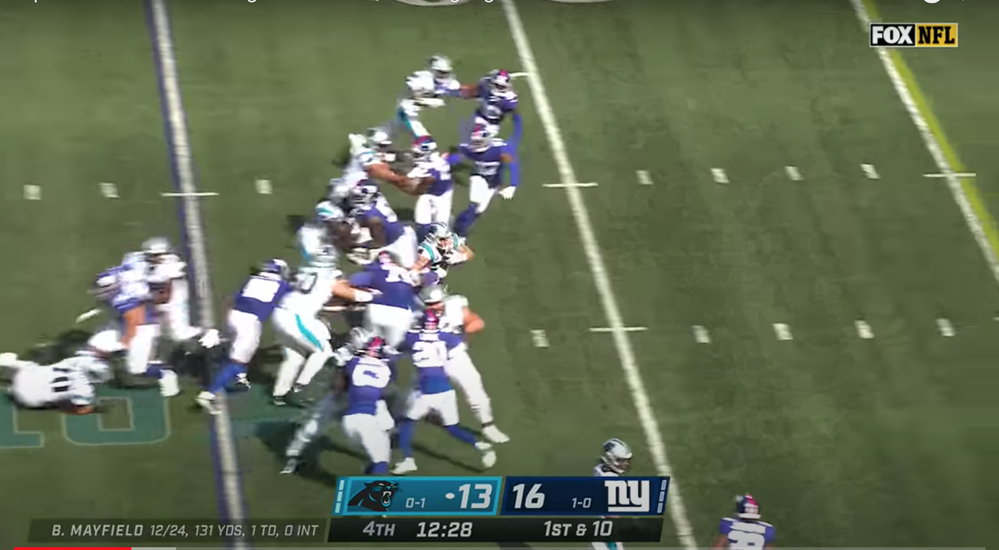

Frame 57
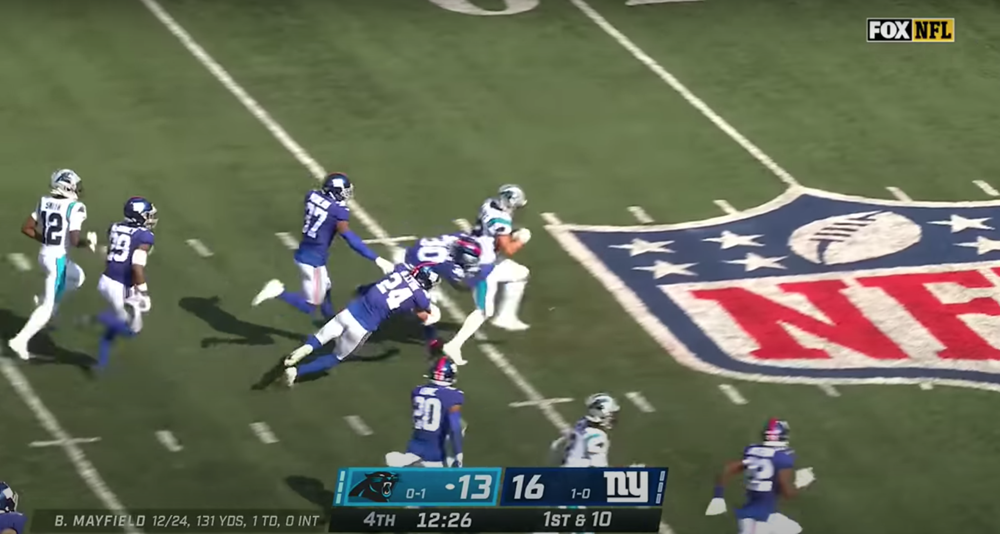

### Tackle:
Frame 90 (eyeball - wrap)
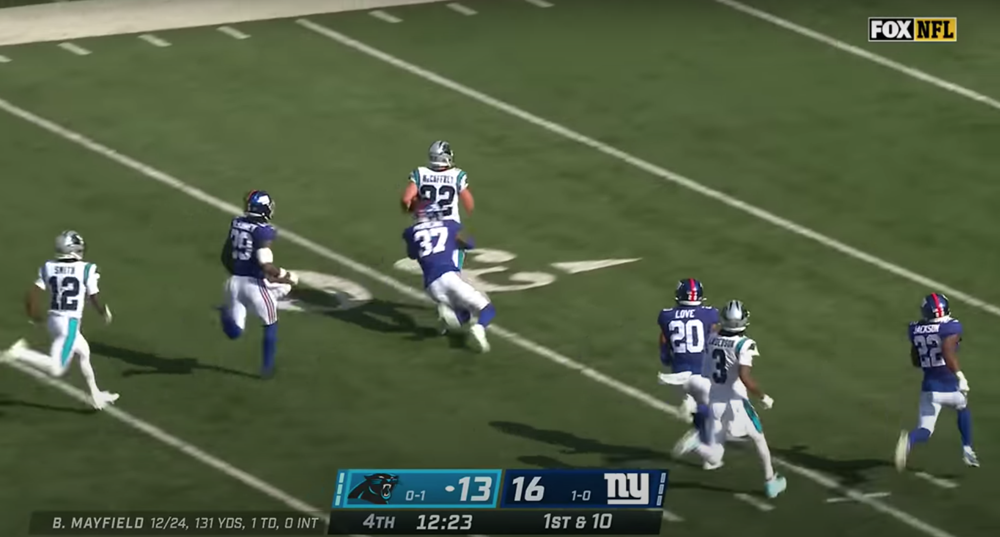

Frame 94 (eyeball - knee down)
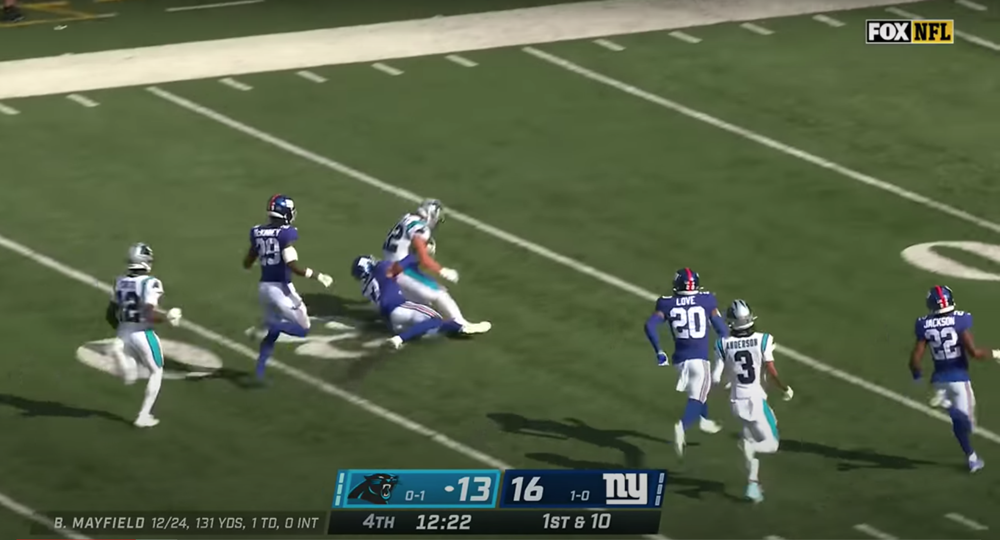

Frame 98 (event = tackle)
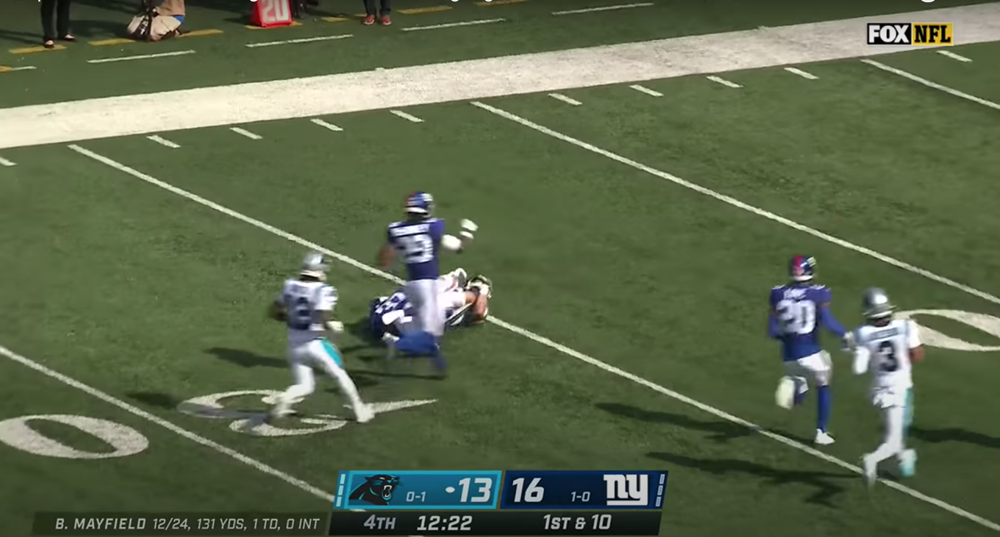

In [137]:
tracking_week_2_df.query('gameId == 2022091805 and playId == 3127 and event == "tackle"')

,gameId,playId,nflId,displayName,frameId,time,jerseyNumber,club,playDirection,x,y,s,a,dis,o,dir,event
584913,2022091805,3127,41336.0,Justin Ellis,98,2022-09-18 15:31:36.799999,71.0,NYG,left,65.140000,25.00,3.60,1.51,0.37,261.03,245.63,tackle
585015,2022091805,3127,43333.0,Jihad Ward,98,2022-09-18 15:31:36.799999,55.0,NYG,left,58.400000,27.09,5.19,1.00,0.52,236.12,239.65,tackle
585117,2022091805,3127,43808.0,Robby Anderson,98,2022-09-18 15:31:36.799999,3.0,CAR,left,34.960000,18.81,7.74,2.88,0.79,231.40,233.16,tackle
585219,2022091805,3127,44820.0,Christian McCaffrey,98,2022-09-18 15:31:36.799999,22.0,CAR,left,35.070000,10.33,5.38,6.13,0.57,155.11,227.91,tackle
585321,2022091805,3127,44830.0,Adoree' Jackson,98,2022-09-18 15:31:36.799999,22.0,NYG,left,32.370000,18.65,8.89,1.93,0.90,242.81,232.29,tackle
585423,2022091805,3127,44876.0,Taylor Moton,98,2022-09-18 15:31:36.799999,72.0,CAR,left,56.790000,33.39,3.89,1.92,0.41,253.43,263.19,tackle
585525,2022091805,3127,44882.0,Pat Elflein,98,2022-09-18 15:31:36.799999,60.0,CAR,left,70.990000,32.27,1.91,0.47,0.21,253.16,256.04,tackle
585627,2022091805,3127,44893.0,Fabian Moreau,98,2022-09-18 15:31:36.799999,37.0,NYG,left,36.030000,10.30,5.81,4.41,0.60,201.61,219.71,tackle
585729,2022091805,3127,46070.0,Baker Mayfield,98,2022-09-18 15:31:36.799999,6.0,CAR,left,87.190000,27.13,2.16,0.30,0.21,280.80,264.27,tackle
585831,2022091805,3127,46093.0,D.J. Moore,98,2022-09-18 15:31:36.799999,2.0,CAR,left,56.420000,20.02,4.92,0.86,0.49,263.94,248.70,tackle


In [139]:
tracking_week_2_df.query('gameId == 2022091805 and playId == 3127 and event == "first_contact"')

,gameId,playId,nflId,displayName,frameId,time,jerseyNumber,club,playDirection,x,y,s,a,dis,o,dir,event
584852,2022091805,3127,41336.0,Justin Ellis,37,2022-09-18 15:31:30.700000,71.0,NYG,left,81.120000,31.090000,3.93,1.17,0.41,217.61,259.81,first_contact
584954,2022091805,3127,43333.0,Jihad Ward,37,2022-09-18 15:31:30.700000,55.0,NYG,left,81.700000,30.290000,3.79,1.32,0.38,60.55,307.36,first_contact
585056,2022091805,3127,43808.0,Robby Anderson,37,2022-09-18 15:31:30.700000,3.0,CAR,left,79.140000,38.740000,5.58,1.57,0.56,250.87,245.97,first_contact
585158,2022091805,3127,44820.0,Christian McCaffrey,37,2022-09-18 15:31:30.700000,22.0,CAR,left,79.560000,31.740000,6.87,2.35,0.69,310.38,289.50,first_contact
585260,2022091805,3127,44830.0,Adoree' Jackson,37,2022-09-18 15:31:30.700000,22.0,NYG,left,78.530000,39.910000,5.08,4.50,0.50,209.06,230.77,first_contact
585362,2022091805,3127,44876.0,Taylor Moton,37,2022-09-18 15:31:30.700000,72.0,CAR,left,82.100000,35.240000,3.16,0.79,0.34,336.70,271.44,first_contact
585464,2022091805,3127,44882.0,Pat Elflein,37,2022-09-18 15:31:30.700000,60.0,CAR,left,82.830000,32.000000,2.23,0.06,0.23,255.27,267.28,first_contact
585566,2022091805,3127,44893.0,Fabian Moreau,37,2022-09-18 15:31:30.700000,37.0,NYG,left,79.950000,27.600000,4.54,3.54,0.45,342.71,309.37,first_contact
585668,2022091805,3127,46070.0,Baker Mayfield,37,2022-09-18 15:31:30.700000,6.0,CAR,left,97.010000,29.550000,1.59,2.52,0.17,275.71,97.67,first_contact
585770,2022091805,3127,46093.0,D.J. Moore,37,2022-09-18 15:31:30.700000,2.0,CAR,left,81.840000,27.600000,3.40,0.81,0.34,299.96,309.87,first_contact


In [381]:
def simplify_tackles_df(tackles_df):
    # assign the tackle Id for each boolean column
    tackle_ids = tackles_df.copy()
    tackle_ids[
        ["tackle", "assist", "forcedFumble", "pff_missedTackle"]
    ] = tackles_df[["tackle", "assist", "forcedFumble", "pff_missedTackle"]].multiply(
        tackles_df["tacklerId"],
        axis="index"
    )

    # melt (unpivot) to make computing distance to ball carrier easier
    tackle_melt = pd.melt(tackle_ids, id_vars=['gameId', 'playId'],
                         value_vars=["tackle", "assist", "forcedFumble", "pff_missedTackle"])
    tackle_melt.rename(columns={'variable': 'event', 'value': 'nflId'}, inplace=True)

    # remove all extra rows
    tackle_simple = tackle_melt.query('nflId != 0')
    return tackle_simple

def player_dist_to_ball_carrier(plays_df, tracking_df):
    # get ball carrier tracking details for each frame
    ball_carrier_tracking_df = plays_df[['gameId', 'playId', 'ballCarrierId']].merge(
                                    tracking_df[['gameId', 'playId', 'nflId', 'frameId',
                                                 'club', 'playDirection', 'x', 'y',
                                                 's', 'a', 'dis', 'o', 'dir']],
                                    left_on=['gameId', 'playId', 'ballCarrierId'],
                                    right_on=['gameId', 'playId', 'nflId']
                        )
    # add ball carrier position to every row of tracking data
    ball_carrier_dist = ball_carrier_tracking_df.merge(
                                tracking_df[['gameId', 'playId', 'nflId', 'frameId',
                                             'club', 'playDirection', 'x', 'y',
                                             's', 'a', 'dis', 'o', 'dir']],
                                on=['gameId', 'playId', 'frameId'],
                                suffixes=['_ball_carrier', None]
                        )
    
    # calculate distance from each player to ball carrier
    ball_carrier_dist['distance'] = ball_carrier_dist_df.apply(
                    lambda row: euclidean((row['x'], row['y']), 
                                          (row['x_ball_carrier'], row['y_ball_carrier']))
                    , axis=1)
    return ball_carrier_dist

def tackler_distance(tackle_simple_df, ball_carrier_dist_df, dist='min'):
    if dist == 'min':
        ball_carrier_min_dist = ball_carrier_dist_df.loc[
            ball_carrier_dist_df.groupby(["gameId", "playId", "nflId"])["distance"].idxmin()
        ][['gameId', 'playId', 'nflId', 'frameId', 'club', 'playDirection', 'x', 'y',
           's', 'a', 'dis', 'o', 'dir', 'club_ball_carrier', 'distance',
           'x_ball_carrier', 'y_ball_carrier', 's_ball_carrier', 'a_ball_carrier',
           'dis_ball_carrier', 'o_ball_carrier', 'dir_ball_carrier']]
    else:
        raise ValueError()
    tackles_dist = tackle_simple_df.merge(
                        ball_carrier_min_dist,
                        on=['gameId', 'playId', 'nflId'],
                        how='right')
    tackles_dist.rename(columns={'distance': 'min_dist'}, inplace=True)
    tackles_dist['event'].fillna('None', inplace=True)
    return tackles_dist

In [382]:
tackle_simple_df = simplify_tackles_df(tackles_df)
ball_carrier_dist_df = player_dist_to_ball_carrier(plays_df, tracking_week_1_df)
df = tackler_distance(tackle_simple_df, ball_carrier_dist_df)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fd86f3d0350>,
      dtype=object)

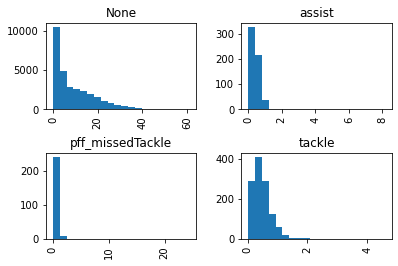

In [383]:
df.query('event != "forcedFumble"')[['event', 'min_dist']].hist(by='event', bins=20)

In [390]:
def dist_group(row):
    dist_range = 'unknown'
    if row.min_dist < 0.5:
        dist_range = '0 - 0.5'
    elif row.min_dist < 1:
        dist_range = '0.5 - 1'
    elif row.min_dist < 2:
        dist_range = '1 - 2'
    else:
        dist_range = '>2'
    return dist_range

In [391]:
df['dist_group'] = df.apply(dist_group, axis=1)

In [392]:
df.query("club != club_ball_carrier").groupby(['event', 'dist_group']).size().unstack('dist_group')

dist_group,0 - 0.5,0.5 - 1,1 - 2,>2
event,,,,
None,617.0,963.0,1565.0,11007.0
assist,381.0,186.0,18.0,4.0
forcedFumble,15.0,9.0,1.0,NaN
pff_missedTackle,68.0,147.0,34.0,7.0
tackle,741.0,402.0,64.0,7.0


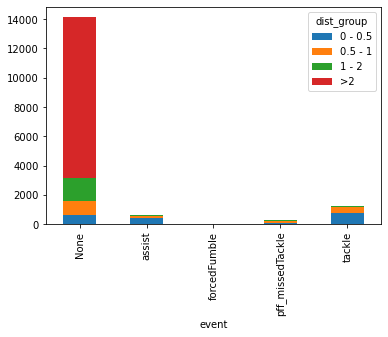

In [393]:
df.query("club != club_ball_carrier").groupby(['event', 'dist_group']).size().unstack('dist_group').plot(kind='bar', stacked=True)

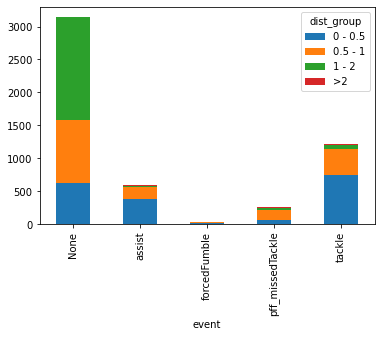

In [396]:
df.query("club != club_ball_carrier and not (event == 'None' and dist_group == '>2')").groupby(['event', 'dist_group']).size().unstack('dist_group').plot(kind='bar', stacked=True)

In [397]:
df

,gameId,playId,event,nflId,frameId,club,playDirection,x,y,s,a,dis,o,dir,club_ball_carrier,min_dist,x_ball_carrier,y_ball_carrier,s_ball_carrier,a_ball_carrier,dis_ball_carrier,o_ball_carrier,dir_ball_carrier,dist_group
0,2022090800,56,None,35472.0,22,BUF,left,87.61,27.45,1.75,0.69,0.18,311.06,297.91,BUF,10.366817,79.51,33.92,0.42,0.58,0.01,100.01,60.50,>2
1,2022090800,56,None,38577.0,22,LA,left,79.02,32.62,0.71,2.55,0.09,12.08,71.17,BUF,1.389280,79.51,33.92,0.42,0.58,0.01,100.01,60.50,1 - 2
2,2022090800,56,None,41239.0,22,LA,left,90.09,27.78,2.44,1.11,0.26,290.58,284.16,BUF,12.232579,79.51,33.92,0.42,0.58,0.01,100.01,60.50,>2
3,2022090800,56,None,42392.0,22,BUF,left,86.67,31.26,1.41,1.19,0.14,278.86,296.47,BUF,7.638141,79.51,33.92,0.42,0.58,0.01,100.01,60.50,>2
4,2022090800,56,None,42489.0,1,BUF,left,80.60,38.29,6.23,0.90,0.62,140.05,189.38,BUF,0.000000,80.60,38.29,6.23,0.90,0.62,140.05,189.38,0 - 0.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32434,2022091200,3826,None,52491.0,53,DEN,left,60.01,15.63,3.52,1.71,0.37,223.70,231.77,DEN,6.341372,55.72,10.96,1.01,3.05,0.12,277.39,320.94,>2
32435,2022091200,3826,None,52526.0,53,DEN,left,53.39,13.69,1.84,2.76,0.20,123.00,169.13,DEN,3.589122,55.72,10.96,1.01,3.05,0.12,277.39,320.94,>2
32436,2022091200,3826,None,53464.0,1,DEN,left,70.71,13.90,4.01,1.45,0.41,8.68,178.63,DEN,0.000000,70.71,13.90,4.01,1.45,0.41,8.68,178.63,0 - 0.5
32437,2022091200,3826,None,54505.0,37,SEA,left,59.30,7.50,5.74,4.83,0.57,241.92,240.13,DEN,0.912688,58.39,7.43,4.79,3.11,0.49,284.57,306.55,0.5 - 1
